In [1]:
import scanpy as sc
import squidpy as sq
import numpy as np
import pandas as pd
from anndata import AnnData
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
import skimage

# import tangram for spatial deconvolution
import tangram as tg

sc.logging.print_header()
print(f"squidpy=={sq.__version__}")
print(f"tangram=={tg.__version__}")

/opt/anaconda3/envs/tangram/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.8.1 pandas==1.4.2 scikit-learn==1.1.1 statsmodels==0.13.2 python-igraph==0.9.10 pynndescent==0.5.7
squidpy==1.2.2
tangram==1.0.3


In [2]:
# Define a nice colour map for gene expression
from matplotlib import rcParams
from matplotlib import colors
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7, 0.8, 20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list("my_colormap", colorsComb)

In [3]:
# mpl.use("module://ipykernel.pylab.backend_inline")
sc.logging.print_header()
sc.set_figure_params(facecolor="white", figsize=(5, 5),fontsize=18, dpi_save=300, dpi=100)
sc.settings.verbosity = 3

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.8.1 pandas==1.4.2 scikit-learn==1.1.1 statsmodels==0.13.2 python-igraph==0.9.10 pynndescent==0.5.7


## Saving and Read data

In [4]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/' 
#this is my file path please adapt it to your directory

In [5]:
sc.settings.figdir = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/Ext.Figures/Ext.4/tangram_injury_cortex/'

In [6]:
data_dir = file_path + 'data/' 

### sc-data

In [11]:
adata_autogenes=sc.read('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/data_autogene/adata_autogenes-2.h5ad')

In [12]:
adata_autogenes

AnnData object with n_obs × n_vars = 6322 × 19290
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden13', 'leiden2', 'Microglia', 'Disease_associated_microglia', 'Macrophages', 'annotated13', 'annotated2', 'Disease associated microglia', 'Monocytes', 'Granulocytes/ dendritic cells', 'NK cells', 'T cells', 'B-cells', 'Neutrophils', 'Neurons', 'Oligodendrocytes', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'BAM', 'OPCs', 'COPs', 'MOL', 'DAM', 'DC', 'B cells', 'gd T cells', 'Innate lymphoid cells (ILC) 2', 'NKT cells'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p

In [9]:
color2 = ['#DC143C','#008000','#9AD255','#4169E1','#333399','#b3d9ff','#4da6ff','#191970','#fdd2ce','#99ddff', '#e6007a',
          '#fb9084','#00CED1','#cc3333','#BA55D3','#fa9ef7','#f48aa0','#ff8c00','#ffbf00','#20B2AA','#FFB6C1','#7B0099',#21
          '#801a00','#7FFFD4', '#8dd593','#DA0AD3','#e6b3cc','#ffb3db','#8e063b','#bf4080']

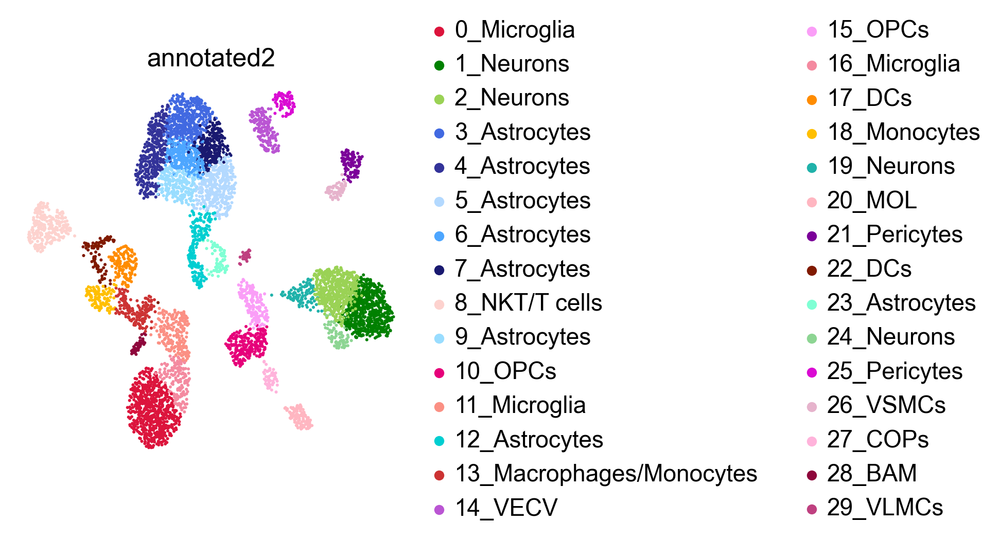

In [10]:
sc.pl.umap(adata_autogenes, color = ('annotated2'),  legend_fontweight= 'bold', frameon= False ,  legend_fontoutline=1,palette=color2)

### visium data

In [7]:
adata2=sc.read("/Volumes/Seagate_Exp/Paper_sc_analysis/data/adata_spatial_3dpi_V_pocessed.h5ad")

In [8]:
adata2

AnnData object with n_obs × n_vars = 1732 × 27998
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters06', 'clusters15', 'clusters1'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters06_colors', 'clusters15_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

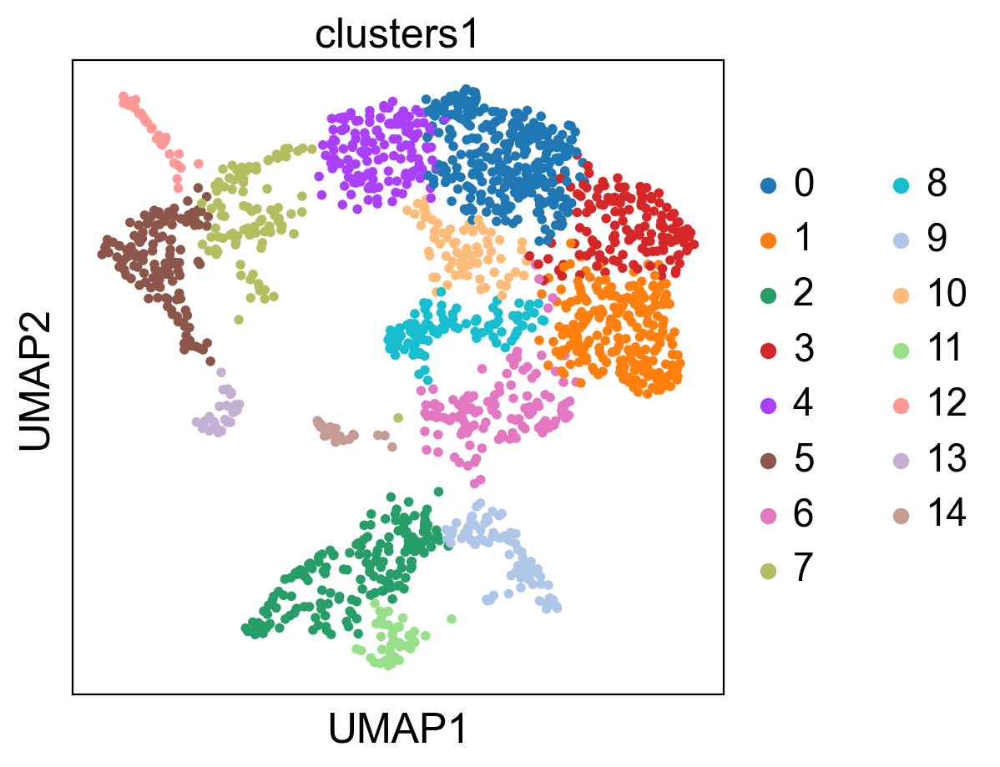

In [9]:
sc.pl.umap(
    adata2, color=["clusters1"], 
)

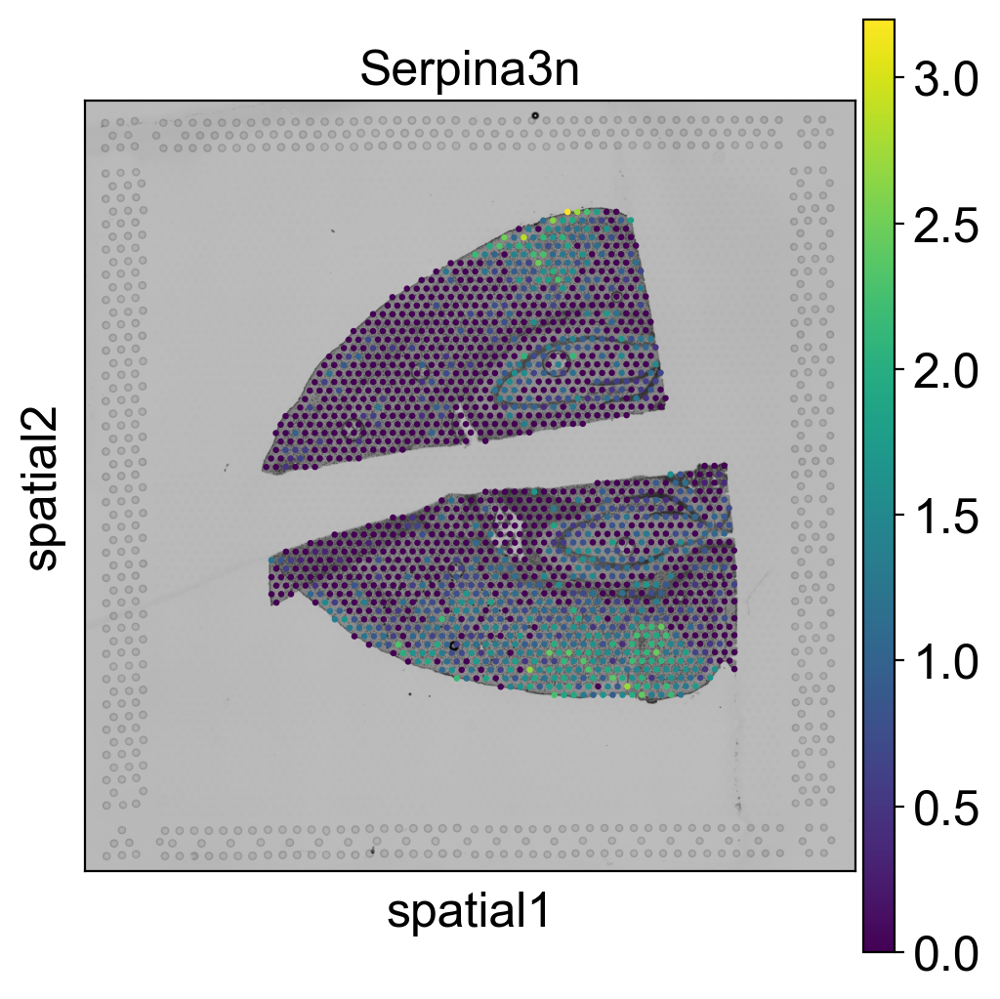

In [10]:
sq.pl.spatial_scatter(adata2, color='Serpina3n')

# Nuclei segmentation and segmentation features

In [25]:
import seaborn as sns

In [26]:
img=sq.im.ImageContainer('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Visium/C3-Composite.tif')

Adding image layer `image`


In [27]:
img

ImageContainer[shape=(7671, 7671), layers=['image']]

In [28]:
img.data

<xarray.Dataset>
Dimensions:  (z: 1, y: 7671, x: 7671, channels: 1)
Coordinates:
  * z        (z) <U1 '0'
Dimensions without coordinates: y, x, channels
Data variables:
    image    (y, x, z, channels) uint8 dask.array<chunksize=(7671, 7671, 1, 1), meta=np.ndarray>
Attributes:
    coords:       CropCoords(x0=0, y0=0, x1=0, y1=0)
    padding:      CropPadding(x_pre=0, x_post=0, y_pre=0, y_post=0)
    scale:        1.0
    mask_circle:  False

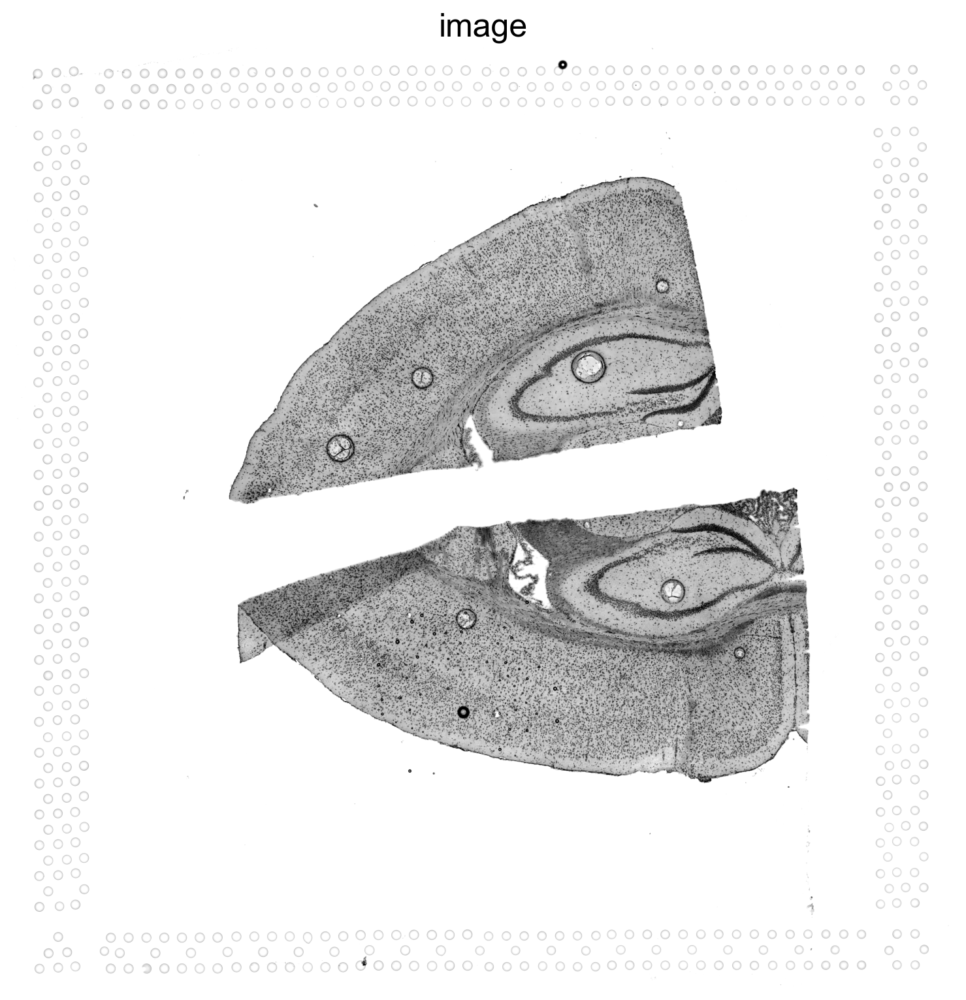

In [29]:
 img.show(cmap='gray')

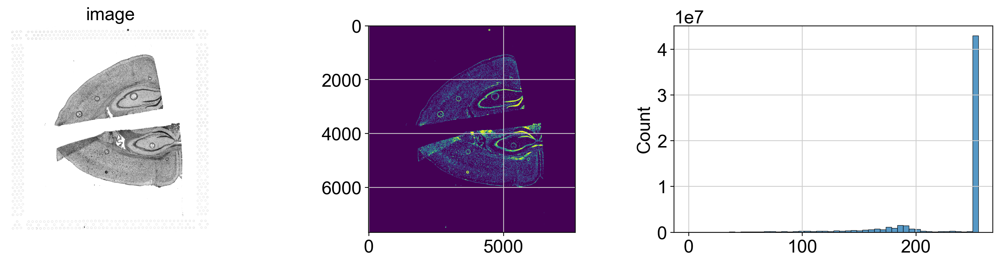

In [30]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
img.show("image", cmap="gray", ax=axes[0])
axes[1].imshow(img["image"][:, :, 0, 0] < 100)
_ = sns.histplot(np.array(img["image"]).flatten(), bins=50, ax=axes[2])
plt.tight_layout()

In [31]:
cropb = img.crop_corner(1200, 4200, size=800)

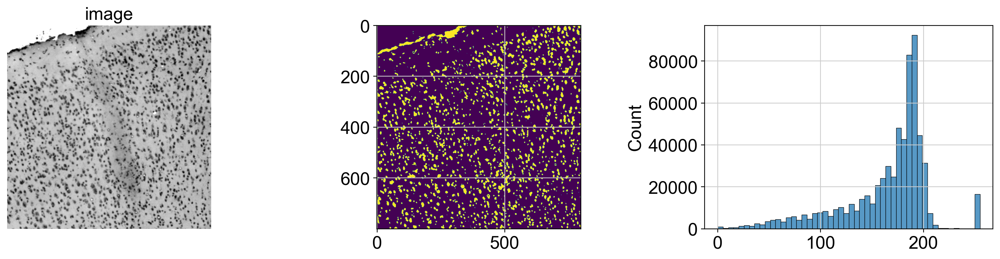

In [32]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
cropb.show("image", cmap="gray", ax=axes[0])
axes[1].imshow(cropb["image"][:, :, 0, 0] < 120)
_ = sns.histplot(np.array(cropb["image"]).flatten(), bins=50, ax=axes[2])
plt.tight_layout()

In [33]:
sq.im.segment(img=img, layer="image", method="watershed", thresh=110, geq=False)

Segmenting an image of shape `(7671, 7671, 1, 1)` using `SegmentationWatershed`
Adding image layer `image`
Finish (0:01:16)
Adding image layer `segmented_watershed`


In [34]:
cropb = img.crop_corner(1200, 4200, size=800)

ImageContainer[shape=(7671, 7671), layers=['image', 'segmented_watershed']]
Number of segments in crop: 2071


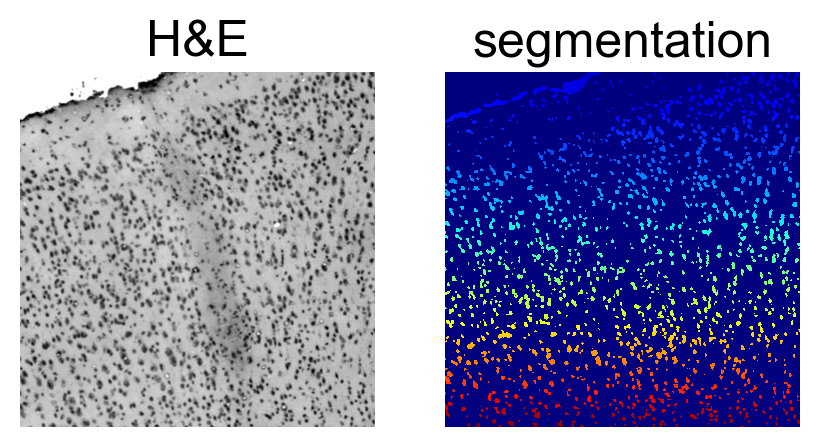

In [35]:
print(img)
print(f"Number of segments in crop: {len(np.unique(cropb['segmented_watershed']))}")

fig, axes = plt.subplots(1, 2)
cropb.show("image",cmap="gray", channel=0, ax=axes[0])
_ = axes[0].set_title("H&E")
cropb.show("segmented_watershed", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

### Keep only cortex 

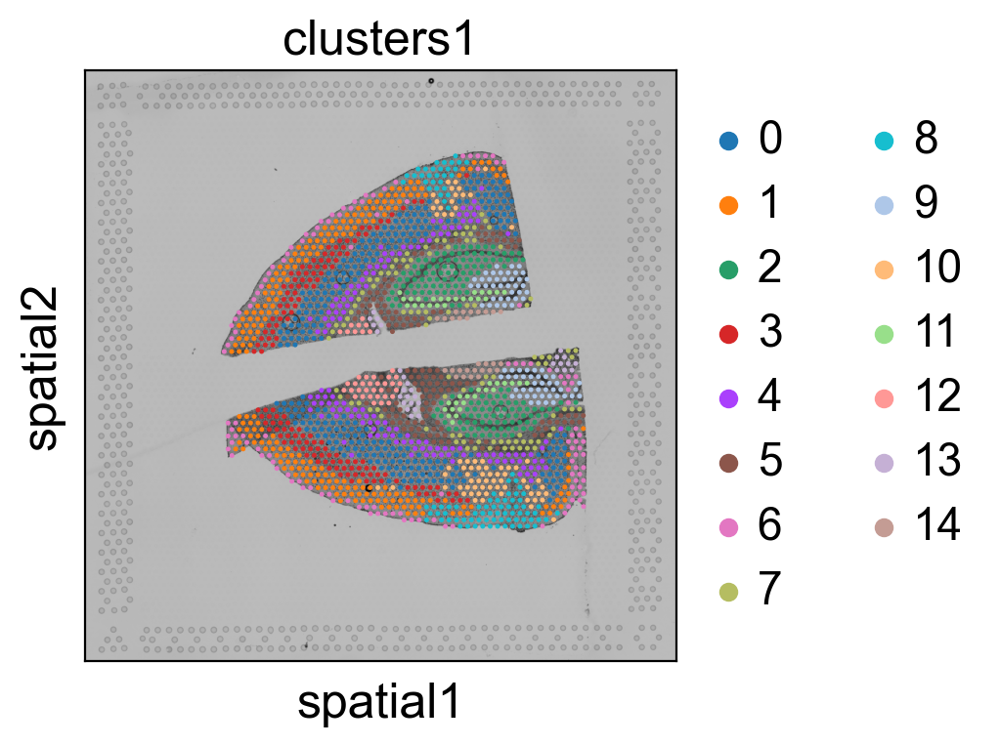

In [36]:
sq.pl.spatial_scatter(adata2, color='clusters1')

In [37]:
adata_st = adata2[
    adata2.obs.clusters1.isin(['0','1','3','4','6','8','10'])
].copy()

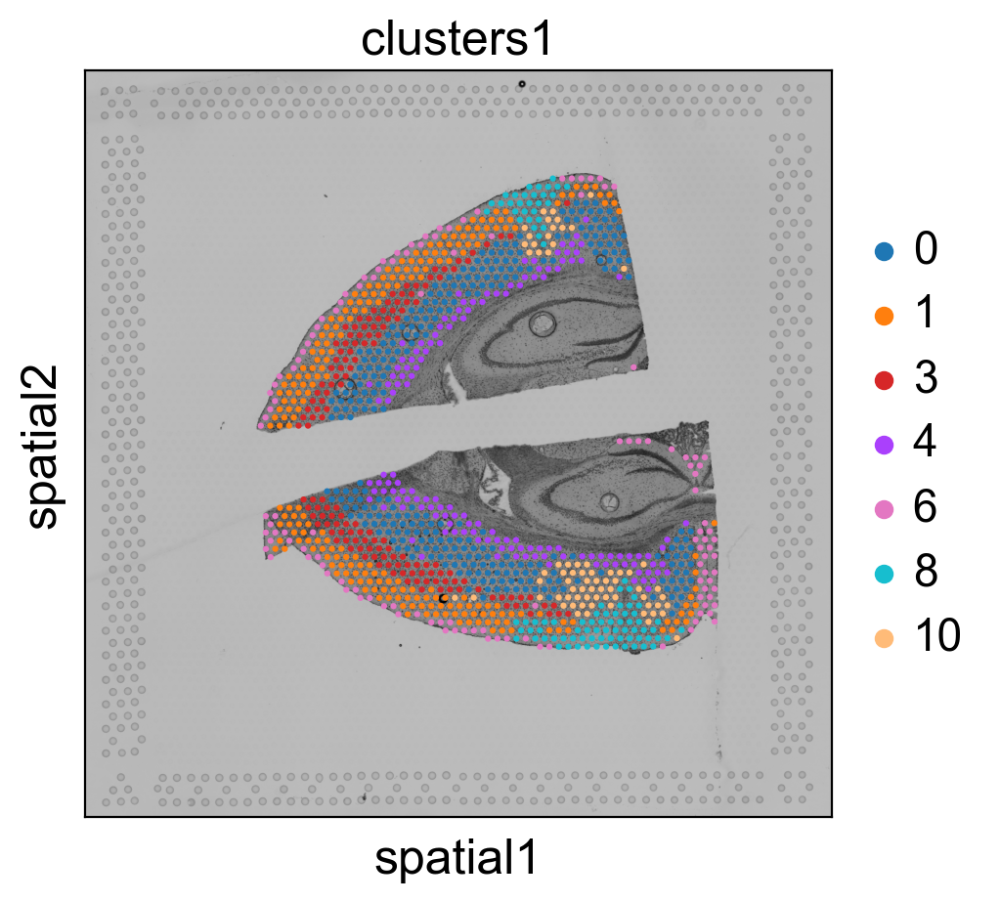

In [38]:
sq.pl.spatial_scatter(adata_st, color='clusters1')

In [39]:
### define image layer to use for segmentation
features_kwargs = {
    "segmentation": {
        "label_layer": "segmented_watershed",
        "props": ["label", "centroid"],
        "channels": [1, 2],
    }
}
# calculate segmentation features
sq.im.calculate_image_features(
    adata_st,
    img,
    layer="image",
    key_added="image_features",
    features_kwargs=features_kwargs,
    features="segmentation",
    mask_circle=True,
)

Calculating features `['segmentation']` using `1` core(s)


100%|█████████████████████████████████████████| 1107/1107 [00:29<00:00, 37.68/s]


Adding `adata.obsm['image_features']`
Finish (0:00:29)


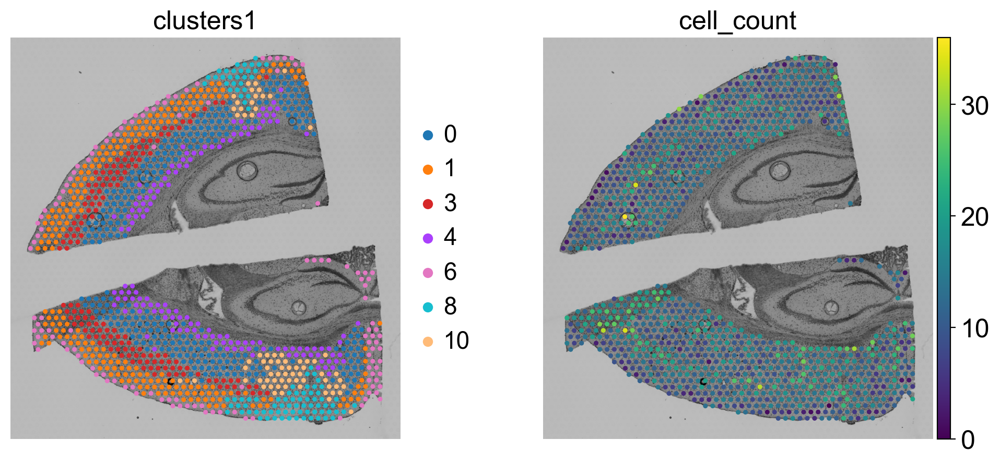

In [40]:
adata_st.obs["cell_count"] = adata_st.obsm["image_features"]["segmentation_label"]
sc.pl.spatial(adata_st, color=["clusters1", "cell_count"], frameon=False)

In [41]:
adata_st2=adata_st.copy()

### Keep only 3dpi_V

In [42]:
adata_autogenes

AnnData object with n_obs × n_vars = 6322 × 19290
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden13', 'leiden2', 'Microglia', 'Disease_associated_microglia', 'Macrophages', 'annotated13', 'annotated2', 'Disease associated microglia', 'Monocytes', 'Granulocytes/ dendritic cells', 'NK cells', 'T cells', 'B-cells', 'Neutrophils', 'Neurons', 'Oligodendrocytes', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'BAM', 'OPCs', 'COPs', 'MOL', 'DAM', 'DC', 'B cells', 'gd T cells', 'Innate lymphoid cells (ILC) 2', 'NKT cells'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p

In [43]:
adata_autogenes3dpi = adata_autogenes[np.in1d(adata_autogenes.obs['condition'],
                           ['3dpi_V'])].copy()

# Pre-processing

# keep autogenes

In [44]:
autogenes_genes = adata_autogenes3dpi[:,adata_autogenes3dpi.var.autogenes_500].var_names

In [45]:
genes_st2 = adata_st2.var_names.values
genes2 = list(set(autogenes_genes).intersection(set(genes_st2)))
len(genes2)


500

In [46]:
adata_st2.var

,gene_ids,feature_types,genome,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,highly_variable,means,dispersions,dispersions_norm
Xkr4,ENSMUSG00000051951,Gene Expression,mm10,False,35,0.021264,0.021041,97.988506,37.0,3.637586,False,2.018965e-02,0.294280,0.249603
Gm1992,ENSMUSG00000089699,Gene Expression,mm10,False,0,0.000000,0.000000,100.000000,0.0,0.000000,False,1.000000e-12,NaN,NaN
Gm37381,ENSMUSG00000102343,Gene Expression,mm10,False,0,0.000000,0.000000,100.000000,0.0,0.000000,False,1.000000e-12,NaN,NaN
Rp1,ENSMUSG00000025900,Gene Expression,mm10,False,1,0.000575,0.000575,99.942529,1.0,0.693147,False,4.342263e-04,-0.284695,-1.324157
Rp1-1,ENSMUSG00000109048,Gene Expression,mm10,False,0,0.000000,0.000000,100.000000,0.0,0.000000,False,1.000000e-12,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC168977.1,ENSMUSG00000079808,Gene Expression,mm10,False,1,0.000575,0.000575,99.942529,1.0,0.693147,False,5.332090e-04,-0.079298,-0.765850
PISD,ENSMUSG00000095041,Gene Expression,mm10,False,1275,2.246552,1.177593,26.724138,3909.0,8.271293,False,1.033327e+00,0.381773,-0.127185
DHRSX,ENSMUSG00000063897,Gene Expression,mm10,False,216,0.139655,0.130726,87.586207,243.0,5.497168,False,1.123031e-01,0.112649,-0.244101
Vmn2r122,ENSMUSG00000096730,Gene Expression,mm10,False,1,0.000575,0.000575,99.942529,1.0,0.693147,False,2.174193e-04,-0.976542,-3.204721


In [47]:
adata_st2.obs.cell_count

AAACAGAGCGACTCCT-1    13
AAACATTTCCCGGATT-1     9
AAACCGTTCGTCCAGG-1    23
AAAGGCTCTCGCGCCG-1    17
AAAGGGATGTAGCAAG-1    17
                      ..
TTGTGGTAGGAGGGAT-1    14
TTGTGGTGGTACTAAG-1    13
TTGTGTATGCCACCAA-1    14
TTGTGTTTCCCGAAAG-1     6
TTGTTAGCAAATTCGA-1    11
Name: cell_count, Length: 1107, dtype: int64

In [48]:
tg.pp_adatas(adata_autogenes3dpi, adata_st2, genes=genes2)

filtered out 793 genes that are detected in less than 1 cells
filtered out 9825 genes that are detected in less than 1 cells


INFO:root:476 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:17261 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [50]:
adata_st2.var

,gene_ids,feature_types,genome,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,highly_variable,means,dispersions,dispersions_norm,n_cells
xkr4,ENSMUSG00000051951,Gene Expression,mm10,False,35,0.021264,0.021041,97.988506,37.0,3.637586,False,0.020190,0.294280,0.249603,23
rp1,ENSMUSG00000025900,Gene Expression,mm10,False,1,0.000575,0.000575,99.942529,1.0,0.693147,False,0.000434,-0.284695,-1.324157,1
sox17,ENSMUSG00000025902,Gene Expression,mm10,False,155,0.101149,0.096355,91.091954,176.0,5.176150,False,0.097249,0.408649,0.560481,116
mrpl15,ENSMUSG00000033845,Gene Expression,mm10,False,984,1.010345,0.698306,43.448276,1758.0,7.472501,False,0.642788,0.225806,-0.434122,659
lypla1,ENSMUSG00000025903,Gene Expression,mm10,False,820,0.738506,0.553026,52.873563,1285.0,7.159292,False,0.497702,0.148282,-0.578067,588
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ac168977.1,ENSMUSG00000079808,Gene Expression,mm10,False,1,0.000575,0.000575,99.942529,1.0,0.693147,False,0.000533,-0.079298,-0.765850,1
pisd-1,ENSMUSG00000095041,Gene Expression,mm10,False,1275,2.246552,1.177593,26.724138,3909.0,8.271293,False,1.033327,0.381773,-0.127185,869
dhrsx,ENSMUSG00000063897,Gene Expression,mm10,False,216,0.139655,0.130726,87.586207,243.0,5.497168,False,0.112303,0.112649,-0.244101,137
vmn2r122,ENSMUSG00000096730,Gene Expression,mm10,False,1,0.000575,0.000575,99.942529,1.0,0.693147,False,0.000217,-0.976542,-3.204721,1


# Find alignment

In [49]:
ad_map = tg.map_cells_to_space(
    adata_autogenes3dpi,
    adata_st2,
    mode="constrained",
    target_count=adata_st2.obs.cell_count.sum(),
    density_prior=np.array(adata_st2.obs.cell_count) / adata_st2.obs.cell_count.sum(),
    num_epochs=1000,
    device="cpu",
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 476 genes and customized density_prior in constrained mode...


Score: 0.444, KL reg: 0.087, Count reg: 13053.135, Lambda f reg: 751.738
Score: 0.745, KL reg: 0.011, Count reg: 11265.274, Lambda f reg: 24.105
Score: 0.750, KL reg: 0.010, Count reg: 11250.601, Lambda f reg: 9.574
Score: 0.751, KL reg: 0.010, Count reg: 11246.413, Lambda f reg: 5.404
Score: 0.751, KL reg: 0.010, Count reg: 11244.555, Lambda f reg: 3.551
Score: 0.752, KL reg: 0.010, Count reg: 11243.545, Lambda f reg: 2.544
Score: 0.752, KL reg: 0.010, Count reg: 11242.927, Lambda f reg: 1.926
Score: 0.752, KL reg: 0.010, Count reg: 11242.517, Lambda f reg: 1.516
Score: 0.752, KL reg: 0.010, Count reg: 11242.229, Lambda f reg: 1.228
Score: 0.752, KL reg: 0.010, Count reg: 11242.018, Lambda f reg: 1.017


INFO:root:Saving results..


In [50]:
tg.project_cell_annotations(ad_map, adata_st2, annotation="annotated2")

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [51]:
adata_st2

AnnData object with n_obs × n_vars = 1107 × 18173
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters06', 'clusters15', 'clusters1', 'cell_count', 'uniform_density', 'rna_count_based_density'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'sparsity'
    uns: 'clusters06_colors', 'clusters15_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'spatial', 'umap', 'clusters1_colors', 'training_genes', 'overlap_genes'
    obsm: 'X_pca', 'X_umap', 'spatial', 'image_features', 'tangram_ct_pred'
    varm: 'PCs'
    laye

In [52]:
annotation_list = list(pd.unique(adata_autogenes3dpi.obs['annotated2']))

In [53]:
set(adata_autogenes3dpi.obs['annotated2'])

{'0_Microglia',
 '10_OPCs',
 '11_Microglia',
 '12_Astrocytes',
 '13_Macrophages/Monocytes',
 '14_VECV',
 '15_OPCs',
 '16_Microglia',
 '17_DCs',
 '18_Monocytes',
 '19_Neurons',
 '1_Neurons',
 '20_MOL',
 '21_Pericytes',
 '22_DCs',
 '23_Astrocytes',
 '24_Neurons',
 '25_Pericytes',
 '26_VSMCs',
 '27_COPs',
 '28_BAM',
 '29_VLMCs',
 '2_Neurons',
 '3_Astrocytes',
 '4_Astrocytes',
 '5_Astrocytes',
 '6_Astrocytes',
 '7_Astrocytes',
 '8_NKT/T cells',
 '9_Astrocytes'}

In [54]:
annotation_list_2=['0_Microglia',
 '10_OPCs',
 '11_Microglia',
 '12_Astrocytes',
 '13_Macrophages/Monocytes',
 '14_VECV',
 '15_OPCs',
 '16_Microglia',
 '17_DCs',
 '18_Monocytes',
 '19_Neurons',
 '1_Neurons',
 '20_MOL',
 '21_Pericytes',
 '22_DCs',
 '23_Astrocytes',
 '24_Neurons',
 '25_Pericytes',
 '26_VSMCs',
 '27_COPs',
 '28_BAM',
 '29_VLMCs',
 '2_Neurons',
 '3_Astrocytes',
 '4_Astrocytes',
 '5_Astrocytes',
 '6_Astrocytes',
 '7_Astrocytes',
 '8_NKT/T cells',
 '9_Astrocytes']

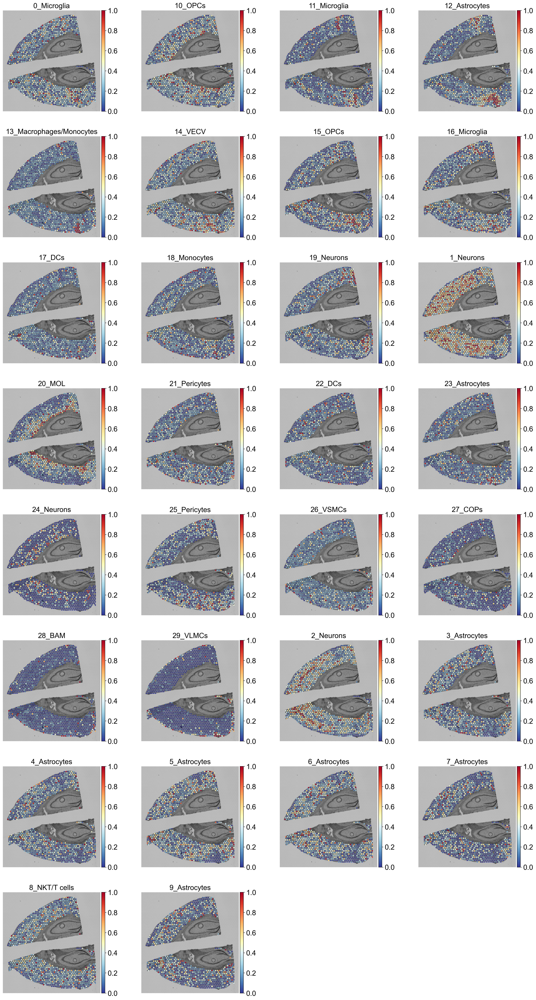

In [62]:
tg.plot_cell_annotation_sc(adata_st2, annotation_list_2, perc=0.02)
plt.tight_layout()
#plt.savefig('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/Figure2/plots/tangram_injury_cortex/annotation_list_2_whole.png', dpi=300)
 

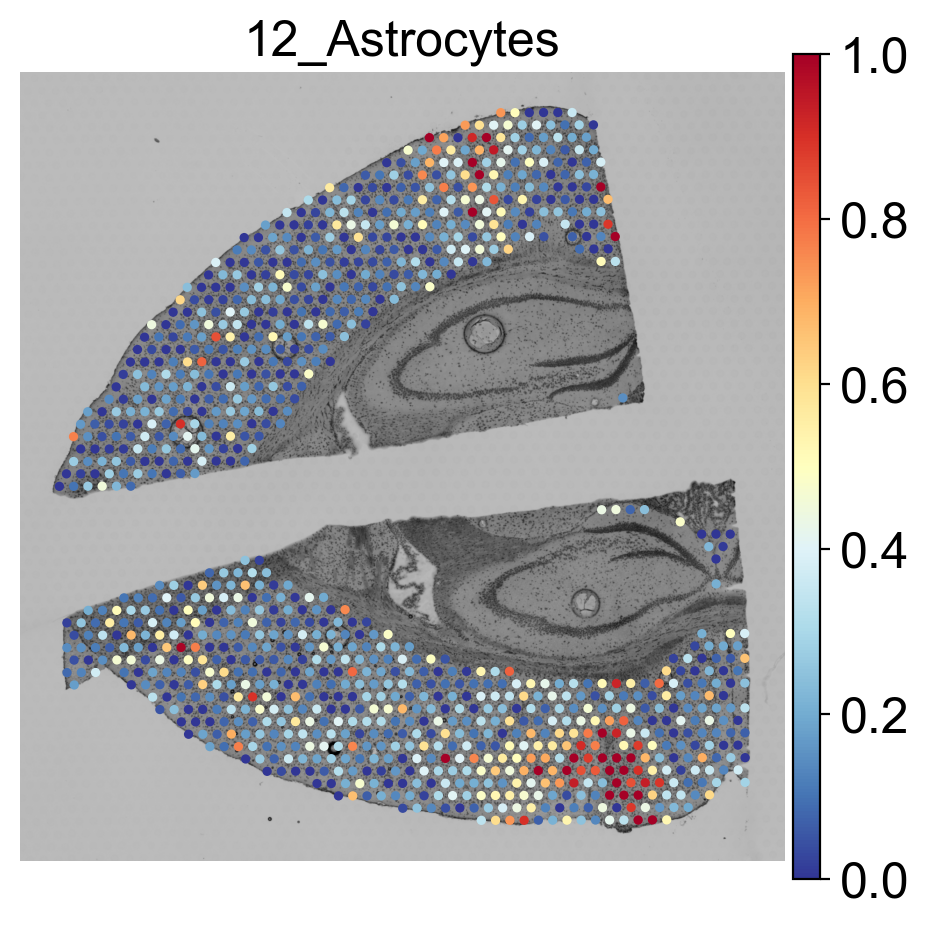

In [56]:
tg.plot_cell_annotation_sc(adata_st2, ['12_Astrocytes'], perc=0.02,)
plt.tight_layout()
#plt.savefig('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/Figure2/plots/annotation_list_12.png', dpi=300)
 

In [63]:
adata_st2write = adata_st2.copy()

In [64]:
adata_st2write

AnnData object with n_obs × n_vars = 1107 × 18173
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters06', 'clusters15', 'clusters1', 'cell_count', 'uniform_density', 'rna_count_based_density'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'sparsity'
    uns: 'clusters06_colors', 'clusters15_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'spatial', 'umap', 'clusters1_colors', 'training_genes', 'overlap_genes'
    obsm: 'X_pca', 'X_umap', 'spatial', 'image_features', 'tangram_ct_pred'
    varm: 'PCs'
    laye

In [65]:
adata_st2write.obsm['image_features'] = adata_st2write.obsm['image_features'].drop('segmentation_centroid',axis=1)

In [66]:
adata_st2.obsm['image_features']

,segmentation_label,segmentation_centroid
AAACAGAGCGACTCCT-1,13,"[[5261.68286936599, 1788.5071113173517], [5261..."
AAACATTTCCCGGATT-1,9,"[[5417.0, 5763.915555555555], [5431.2293103448..."
AAACCGTTCGTCCAGG-1,23,"[[2748.0, 5002.932126354701], [2750.5300015666..."
AAAGGCTCTCGCGCCG-1,17,"[[3379.64979978158, 5233.482821113041], [3379...."
AAAGGGATGTAGCAAG-1,17,"[[3711.0, 2624.790177491899], [3723.8076192170..."
...,...,...
TTGTGGTAGGAGGGAT-1,14,"[[2068.0, 4838.394117647059], [2068.3636650619..."
TTGTGGTGGTACTAAG-1,13,"[[5321.0, 5932.140077821012], [5336.0739178535..."
TTGTGTATGCCACCAA-1,14,"[[3621.0, 5323.518118519952], [3621.8461025874..."
TTGTGTTTCCCGAAAG-1,6,"[[3572.0, 4916.75879396985], [3576.92169983638..."


In [70]:
adata_st2write.write(data_dir+'221120adata_st_injury_cortex_section.h5ad')

# New spatial data via aligned single cells

In [71]:
ad_ge = tg.project_genes(adata_map=ad_map, adata_sc=adata_autogenes3dpi)
df_cortex_genes = tg.compare_spatial_geneexp(ad_ge, adata_st2, adata_autogenes3dpi)

<Figure size 500x500 with 0 Axes>

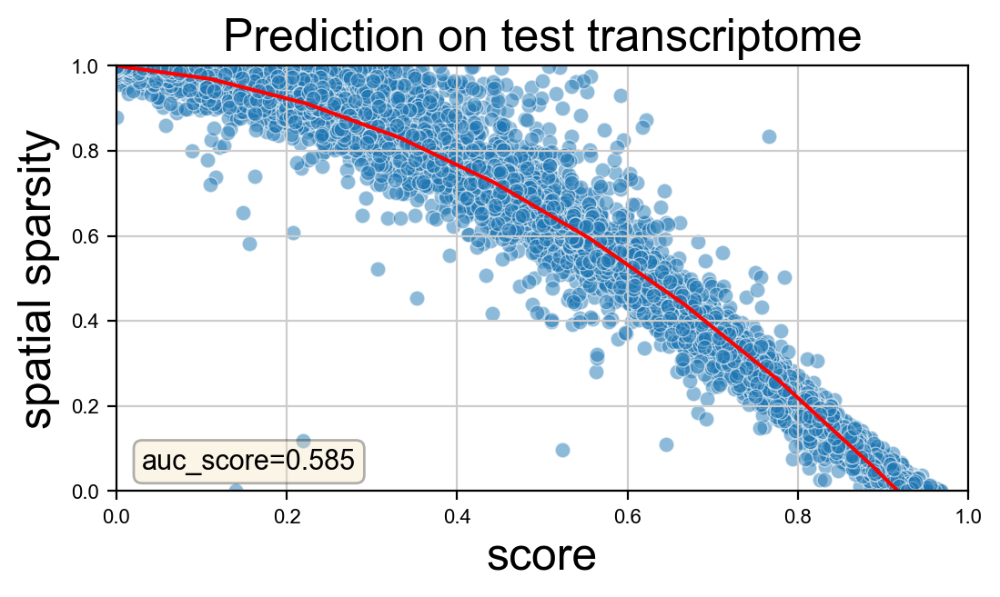

In [72]:
tg.plot_auc(df_cortex_genes);

In [73]:
ad_map.uns['train_genes_df']

,train_score,sparsity_sc,sparsity_sp,sparsity_diff
foxo6os,0.990515,0.998903,0.993677,-0.005226
gsta2,0.986580,0.997806,0.996387,-0.001419
alox8,0.985019,0.996160,0.942186,-0.053974
5330439a09rik,0.981213,0.997806,0.996387,-0.001419
cd209f,0.979573,0.997532,0.991870,-0.005662
...,...,...,...,...
plac8,0.371362,0.835162,0.981030,0.145868
gimap4,0.371284,0.933626,0.990063,0.056437
apbb1ip,0.356916,0.751234,0.932249,0.181015
napsa,0.311694,0.879046,0.994580,0.115534


In [74]:
genes = ['serpina3n', 'lcn2']
ad_map.uns['train_genes_df'].loc[genes]

,train_score,sparsity_sc,sparsity_sp,sparsity_diff
serpina3n,0.770142,0.829676,0.532069,-0.297608
lcn2,0.821407,0.926221,0.805781,-0.120439


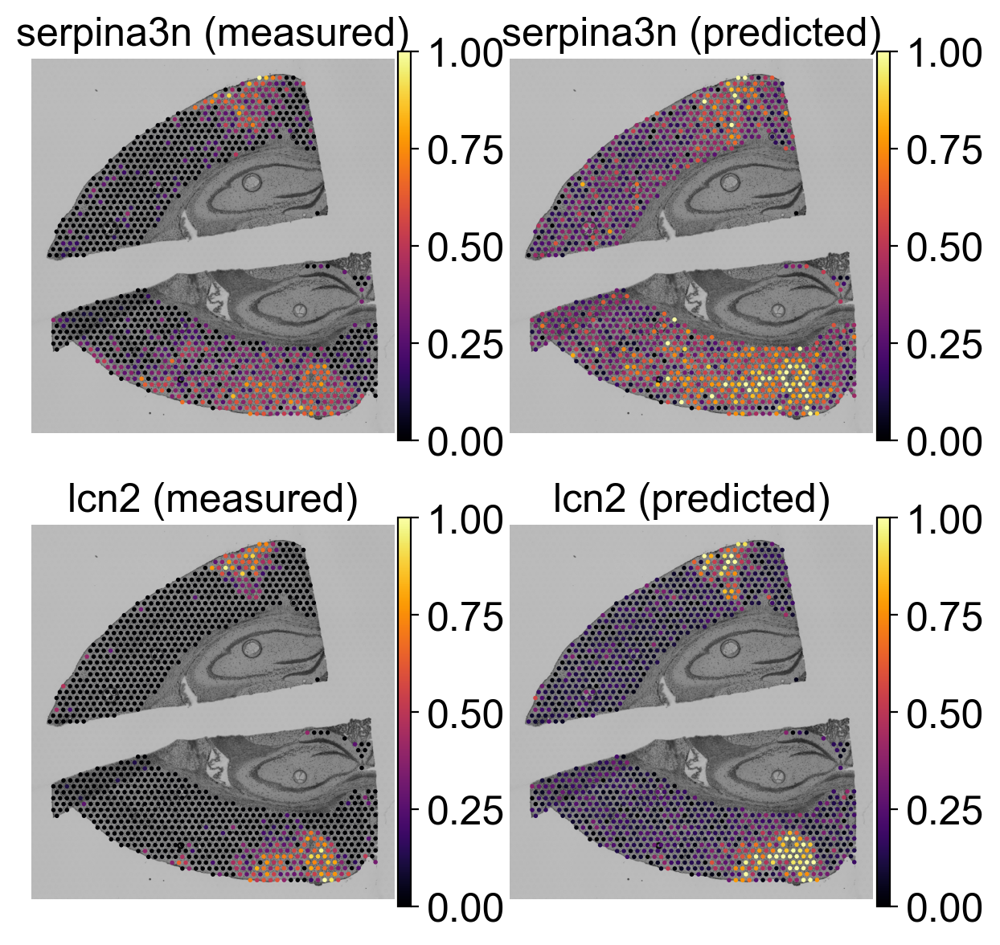

In [75]:
tg.plot_genes_sc(genes, adata_measured=adata_st2, adata_predicted=ad_ge, perc=0.02)

In [76]:
tg.create_segment_cell_df(adata_st2)

In [77]:
adata_st2.uns["tangram_cell_segmentation"].head()


,spot_idx,y,x,centroids
0,AAACAGAGCGACTCCT-1,5261.682869,1788.507111,AAACAGAGCGACTCCT-1_0
1,AAACAGAGCGACTCCT-1,5261.000000,1795.360670,AAACAGAGCGACTCCT-1_1
2,AAACAGAGCGACTCCT-1,5267.913765,1755.253623,AAACAGAGCGACTCCT-1_2
3,AAACAGAGCGACTCCT-1,5271.270861,1769.966335,AAACAGAGCGACTCCT-1_3
4,AAACAGAGCGACTCCT-1,5275.569987,1814.000000,AAACAGAGCGACTCCT-1_4


In [78]:
tg.count_cell_annotations(
    ad_map,
    adata_autogenes3dpi,
    adata_st2,
    annotation="annotated2",
)

In [79]:
adata_st2.obsm["tangram_ct_count"].head()

,x,y,cell_n,centroids,24_Neurons,22_DCs,14_VECV,2_Neurons,18_Monocytes,21_Pericytes,...,15_OPCs,29_VLMCs,6_Astrocytes,20_MOL,25_Pericytes,19_Neurons,23_Astrocytes,9_Astrocytes,28_BAM,27_COPs
AAACAGAGCGACTCCT-1,1782,5292,13,"[AAACAGAGCGACTCCT-1_0, AAACAGAGCGACTCCT-1_1, A...",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAACATTTCCCGGATT-1,5748,5448,9,"[AAACATTTCCCGGATT-1_0, AAACATTTCCCGGATT-1_1, A...",0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0
AAACCGTTCGTCCAGG-1,4995,2779,23,"[AAACCGTTCGTCCAGG-1_0, AAACCGTTCGTCCAGG-1_1, A...",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAAGGCTCTCGCGCCG-1,5247,3410,17,"[AAAGGCTCTCGCGCCG-1_0, AAAGGCTCTCGCGCCG-1_1, A...",0,0,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0
AAAGGGATGTAGCAAG-1,2630,3742,17,"[AAAGGGATGTAGCAAG-1_0, AAAGGGATGTAGCAAG-1_1, A...",0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0


In [80]:
adata_segment2 = tg.deconvolve_cell_annotations(adata_st2)

In [81]:
adata_segment2

AnnData object with n_obs × n_vars = 3610 × 4
    obs: 'y', 'x', 'centroids', 'cluster'
    uns: 'clusters06_colors', 'clusters15_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'spatial', 'umap', 'clusters1_colors', 'training_genes', 'overlap_genes', 'tangram_cell_segmentation'
    obsm: 'spatial'

In [82]:
adata_segment2.uns['cluster_colors']=adata_autogenes.uns["annotated2_colors"]

In [83]:
set(adata_autogenes3dpi.obs['annotated2'])

{'0_Microglia',
 '10_OPCs',
 '11_Microglia',
 '12_Astrocytes',
 '13_Macrophages/Monocytes',
 '14_VECV',
 '15_OPCs',
 '16_Microglia',
 '17_DCs',
 '18_Monocytes',
 '19_Neurons',
 '1_Neurons',
 '20_MOL',
 '21_Pericytes',
 '22_DCs',
 '23_Astrocytes',
 '24_Neurons',
 '25_Pericytes',
 '26_VSMCs',
 '27_COPs',
 '28_BAM',
 '29_VLMCs',
 '2_Neurons',
 '3_Astrocytes',
 '4_Astrocytes',
 '5_Astrocytes',
 '6_Astrocytes',
 '7_Astrocytes',
 '8_NKT/T cells',
 '9_Astrocytes'}

[<AxesSubplot:title={'center':'cluster'}, xlabel='spatial1', ylabel='spatial2'>]

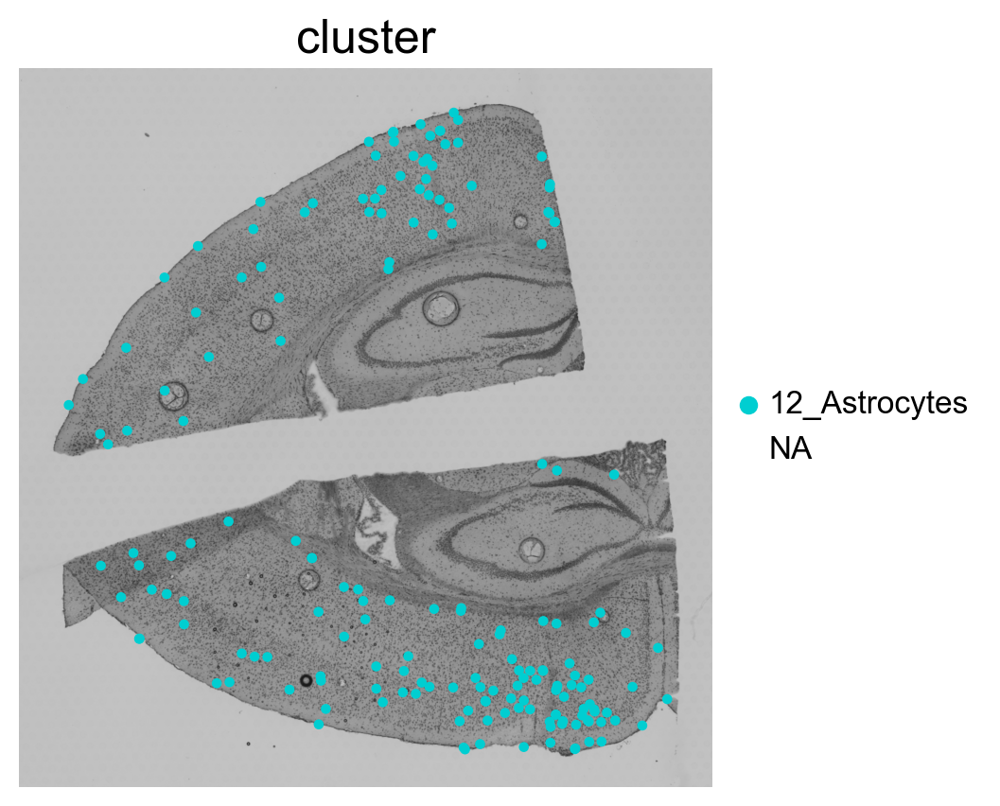

In [84]:
sc.pl.spatial(
    adata_segment2,
    color="cluster",
        groups='12_Astrocytes',    show=False,
    frameon=False,size=1.2,
    alpha_img=0.9,
    legend_fontsize=12,
    library_id='A_3dpi_V', )#save='test_12.png')

[<AxesSubplot:title={'center':'cluster'}, xlabel='spatial1', ylabel='spatial2'>]

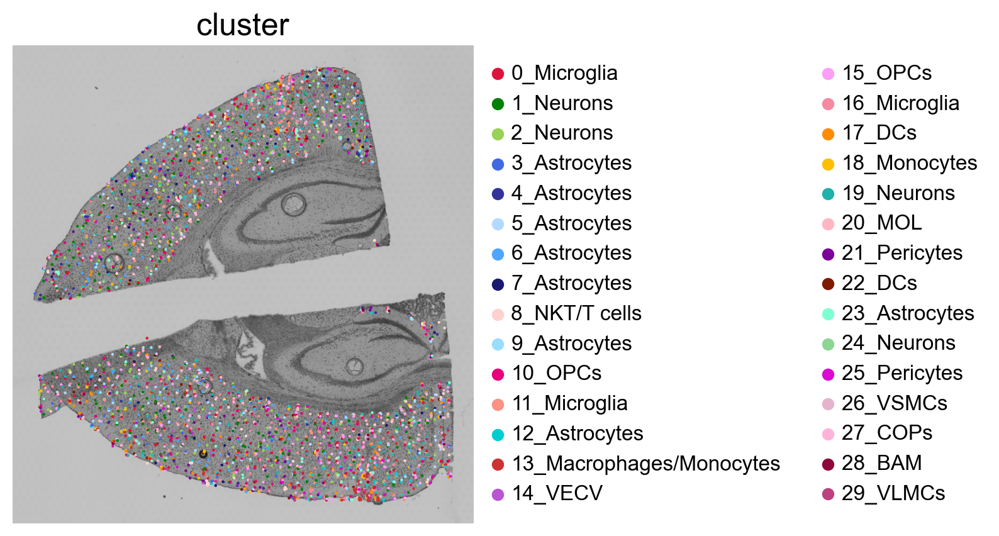

In [85]:
sc.pl.spatial(
    adata_segment2,
    color="cluster",
    size=0.5,
    show=False,
    frameon=False,
    alpha_img=0.9,
    legend_fontsize=12,
    library_id='A_3dpi_V',)# save="_deconv_cortex.png" )

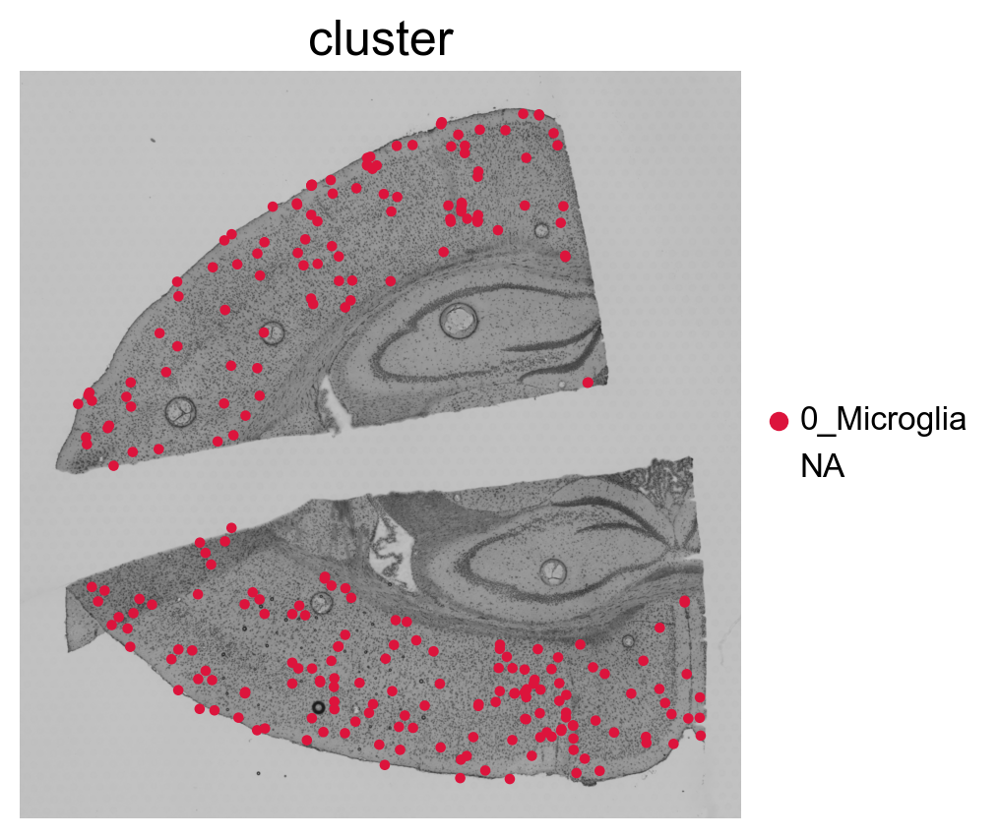

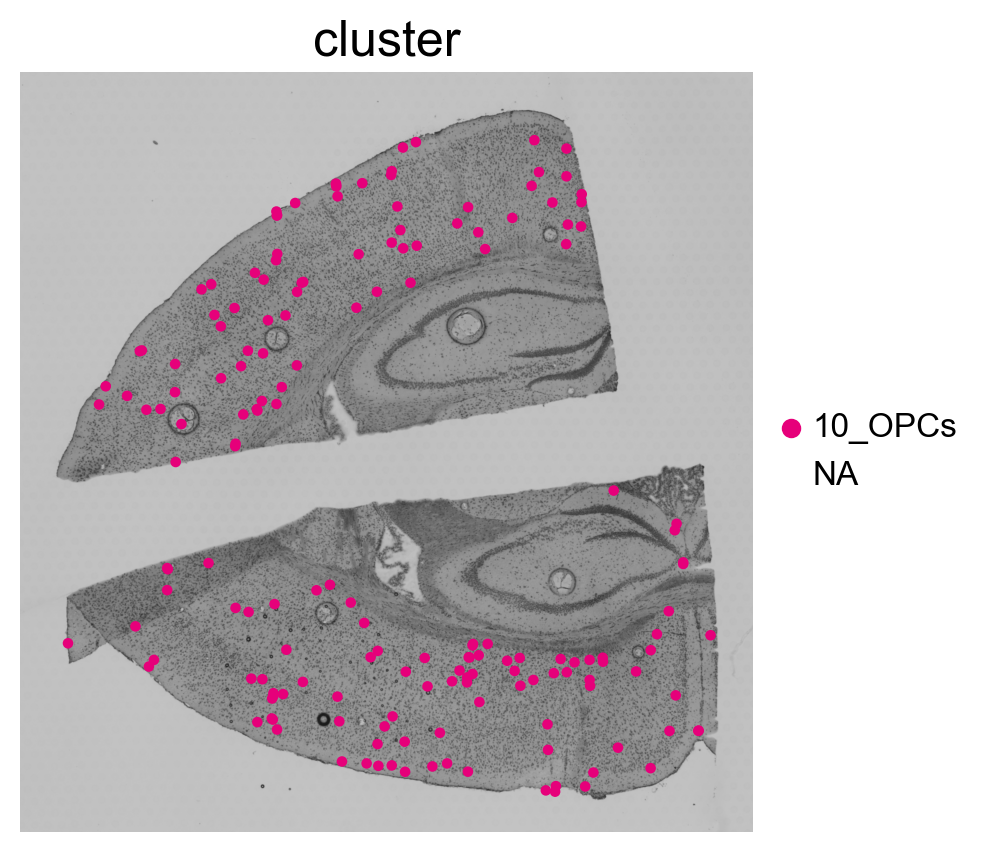

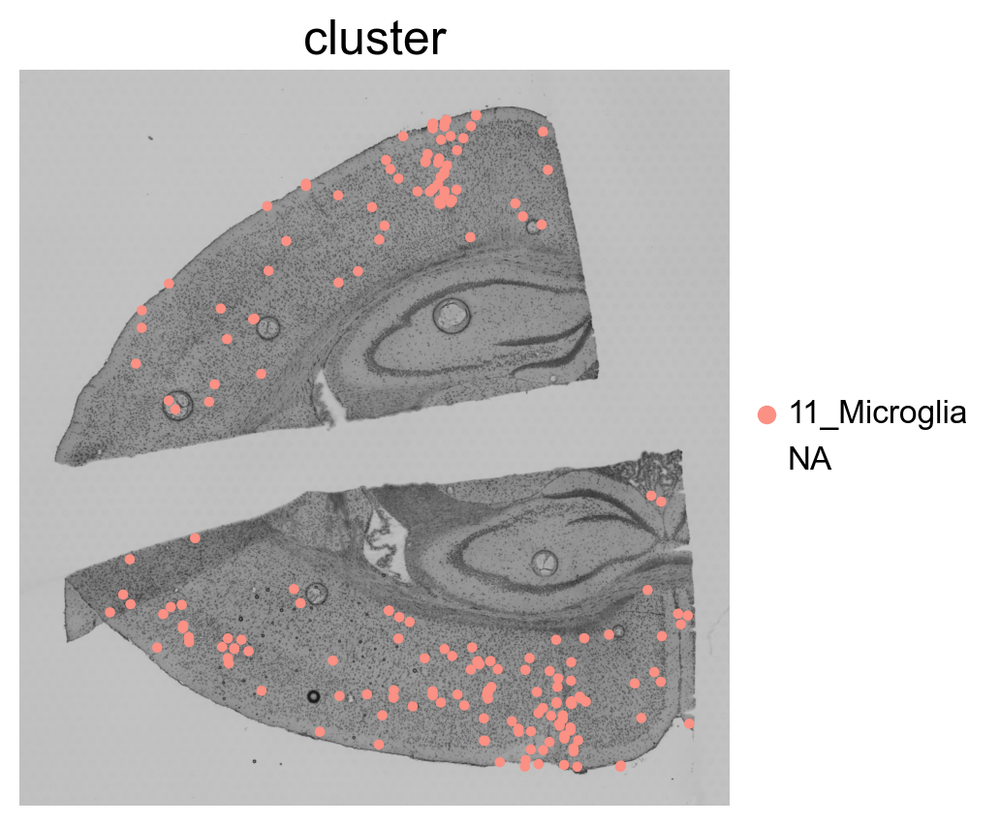

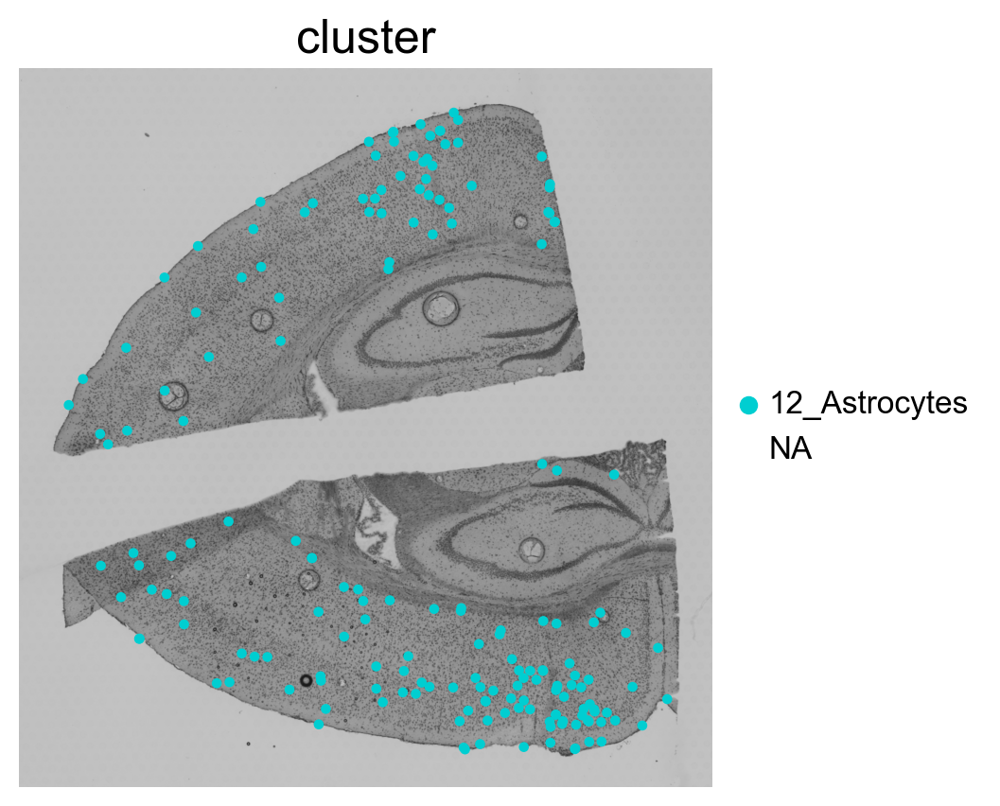

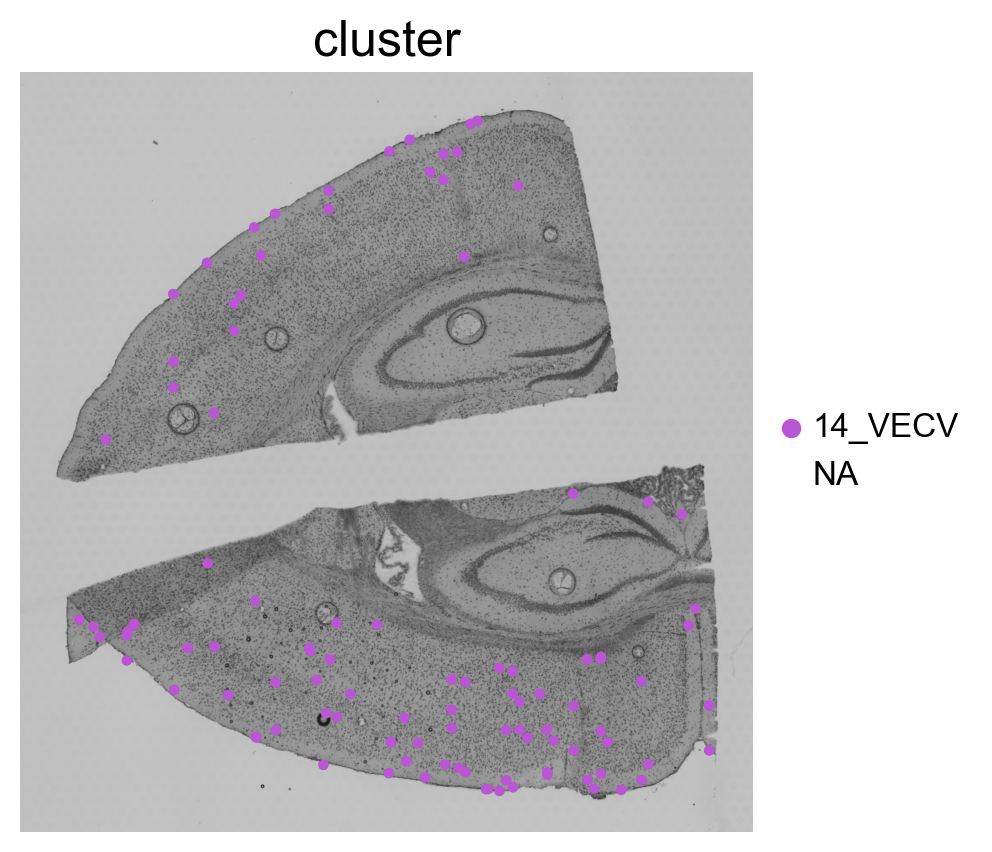

...

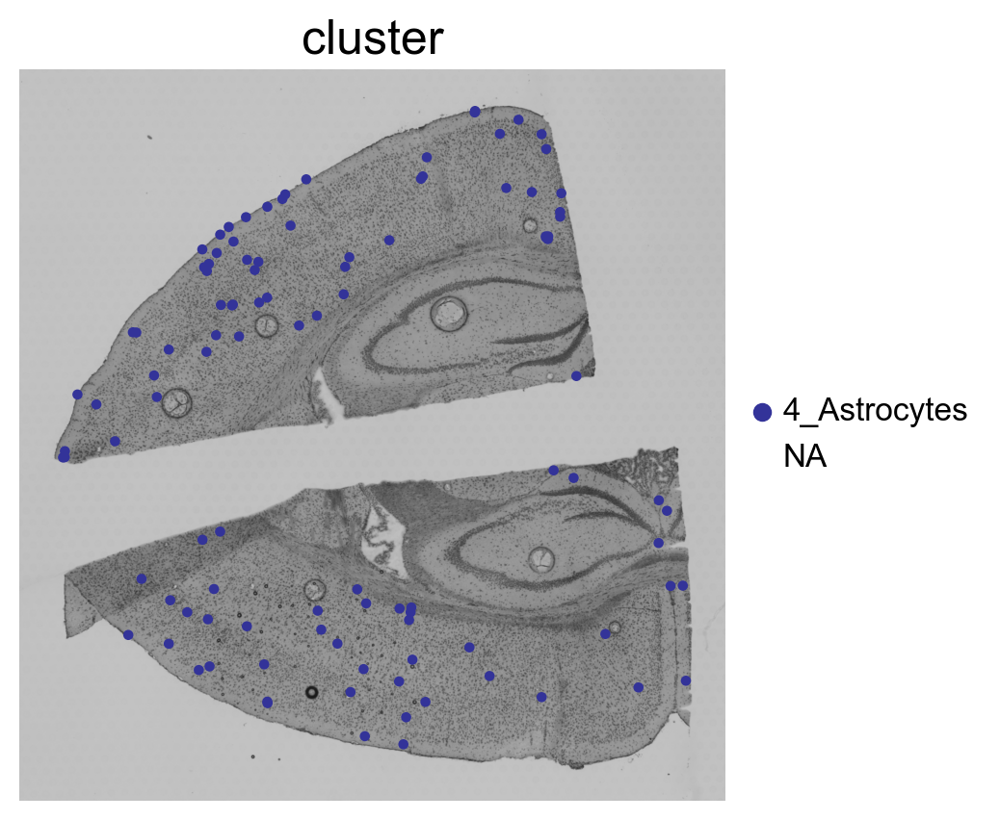

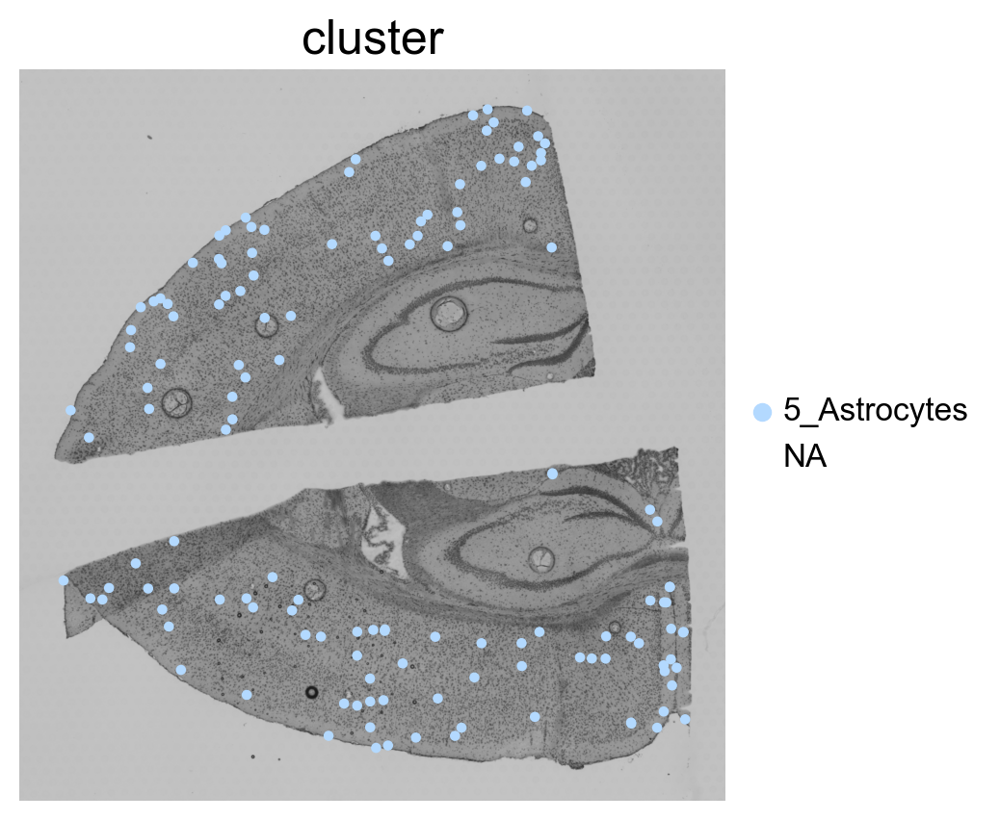

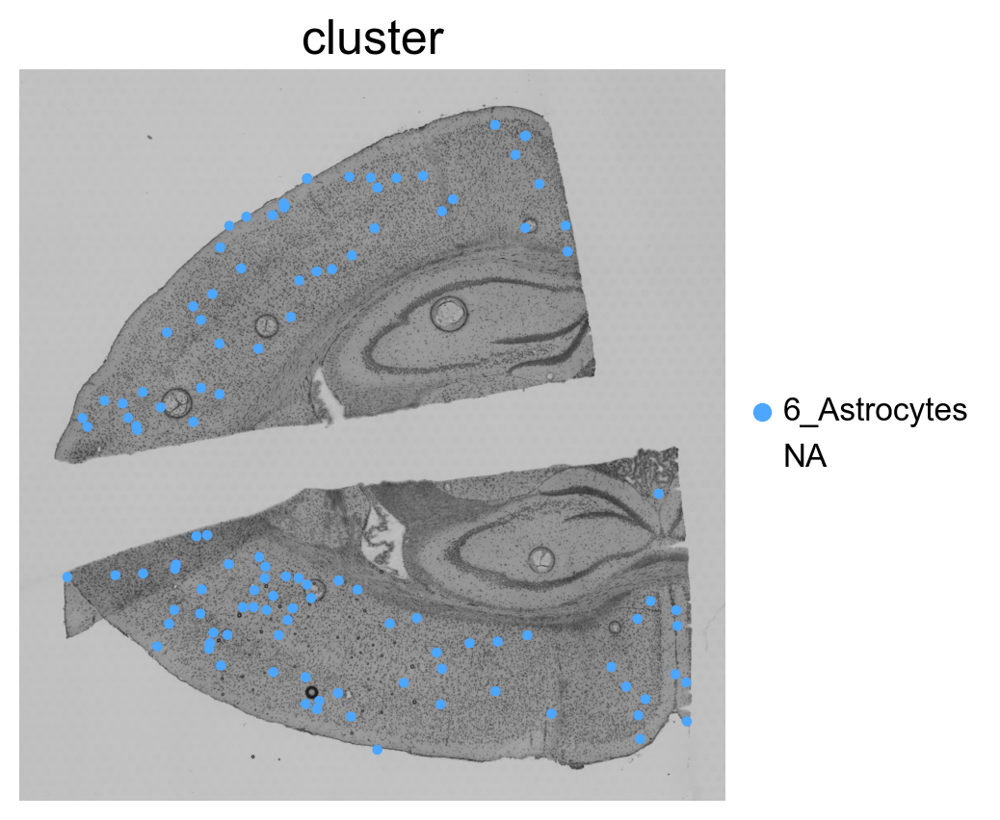

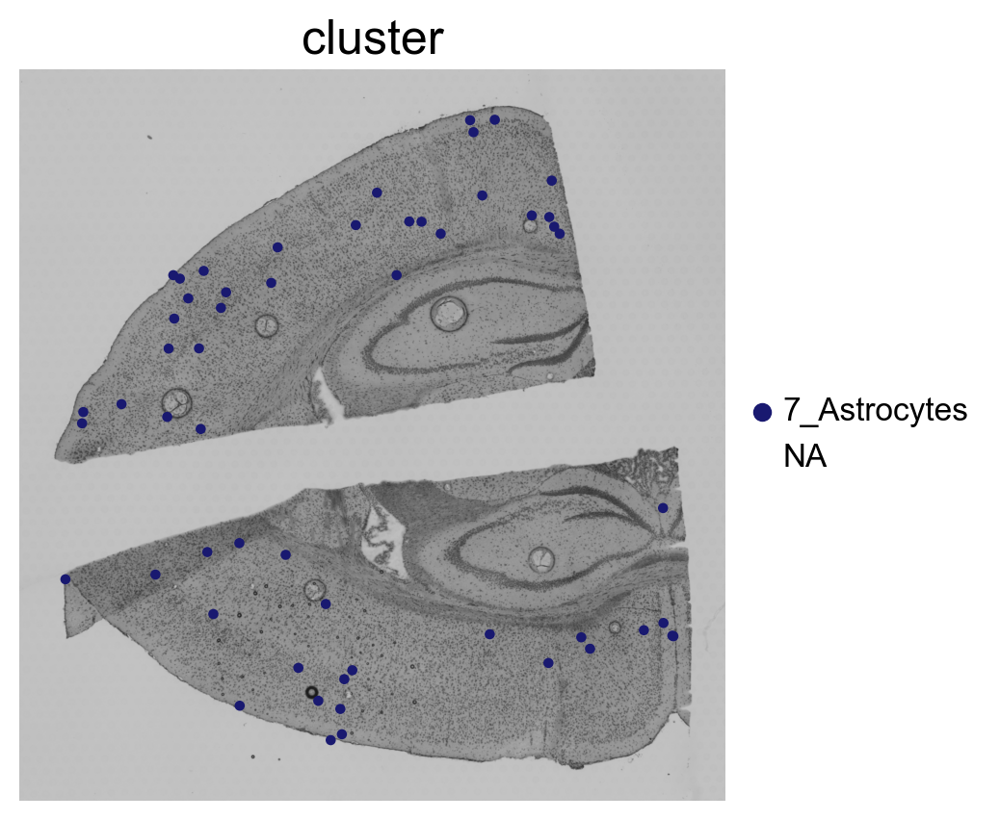

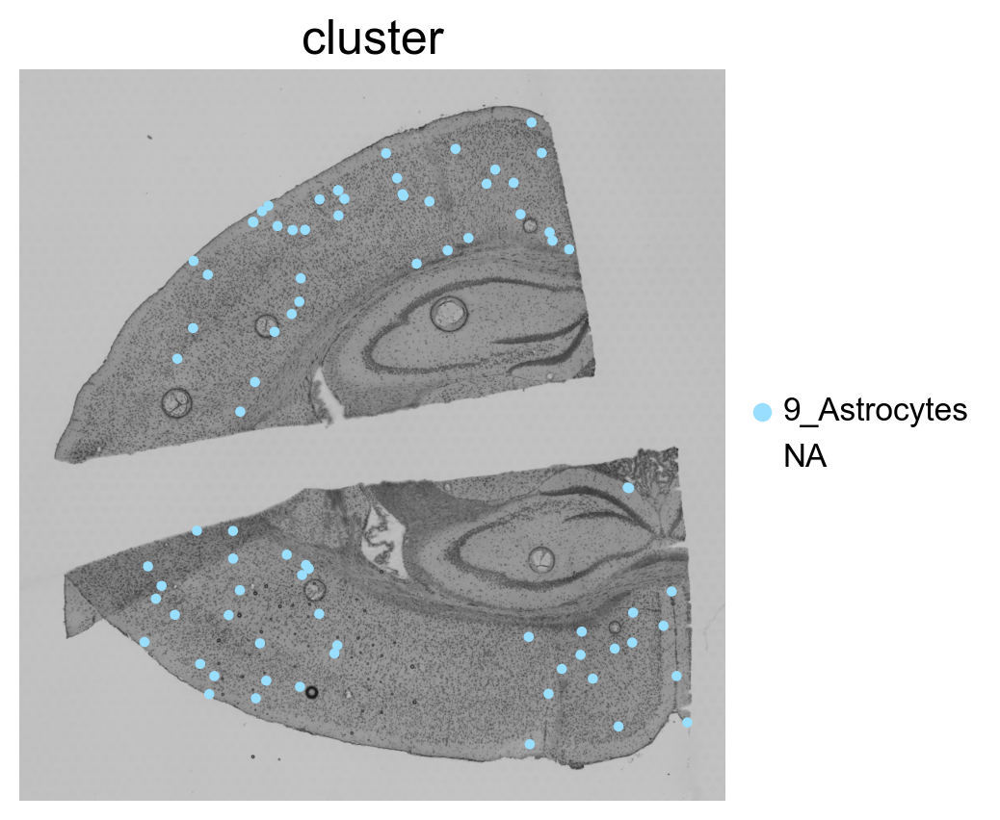

In [86]:
for names in ['0_Microglia',
 '10_OPCs',
 '11_Microglia',
 '12_Astrocytes',
 '14_VECV',
 '15_OPCs',
 '16_Microglia',
 '17_DCs',
 '18_Monocytes',
 '19_Neurons',
 '1_Neurons',
 '20_MOL',
'21_Pericytes',
 '22_DCs',
 '23_Astrocytes',
 '24_Neurons',
 '25_Pericytes',
 '26_VSMCs',
 '27_COPs',
 '28_BAM',
 '29_VLMCs',
 '2_Neurons',
 '3_Astrocytes',
 '4_Astrocytes',
 '5_Astrocytes',
 '6_Astrocytes',
 '7_Astrocytes',
 '9_Astrocytes'
]:
    sc.pl.spatial(
    adata_segment2,
    color="cluster",
        groups=names,
    show=False,
    frameon=False,
    alpha_img=0.9,size=1.2,
    legend_fontsize=12,)#  save=names+"_deconv_cortex.png")

[<AxesSubplot:title={'center':'cluster'}, xlabel='spatial1', ylabel='spatial2'>]

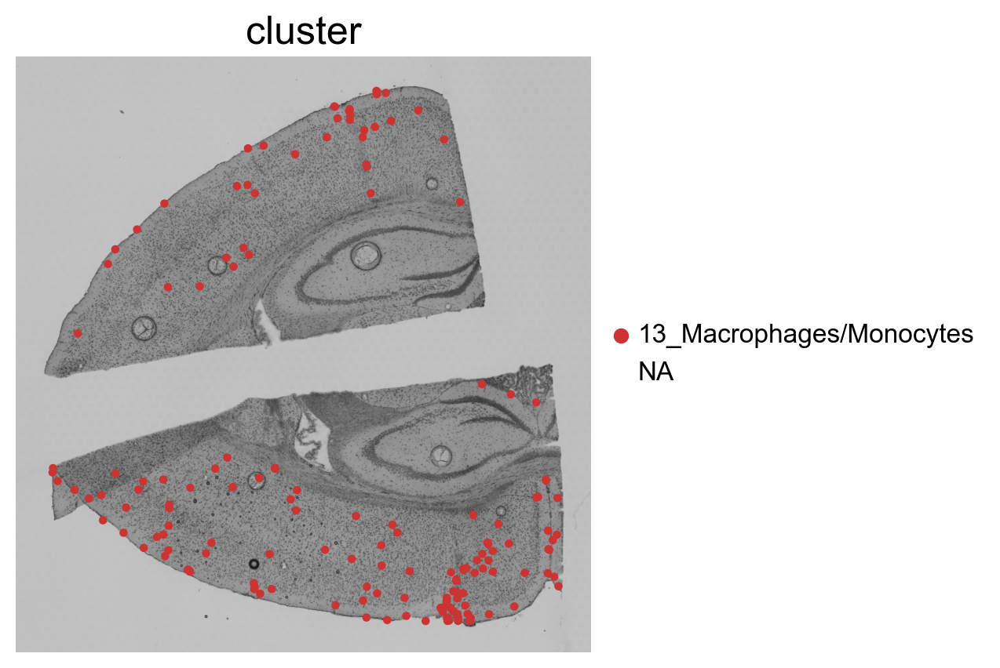

In [87]:
sc.pl.spatial(
    adata_segment2,
    color="cluster",
        groups=[
 '13_Macrophages/Monocytes',
        ],
    size=1.2,
    show=False,
    frameon=False,
    alpha_img=0.9,
    legend_fontsize=12,
    library_id='A_3dpi_V',)#save="13_deconv_cortex.png")

[<AxesSubplot:title={'center':'cluster'}, xlabel='spatial1', ylabel='spatial2'>]

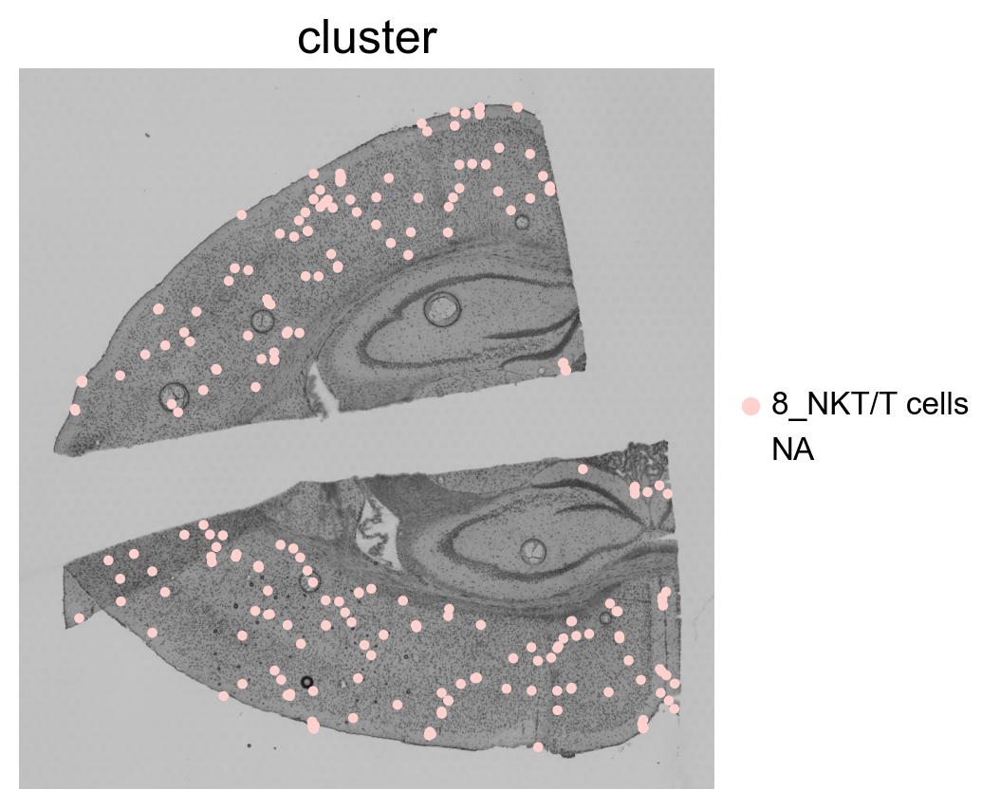

In [88]:
sc.pl.spatial(
    adata_segment2,
    color="cluster",
        groups=['8_NKT/T cells',
        ],
    size=1.2,
    show=False,
    frameon=False,
    alpha_img=0.9,
    legend_fontsize=12,
    library_id='A_3dpi_V',)#save="8_deconv_cortex.png")